# Planning Stage Report – Group 4 | STAT 301 (2025SS)

**Student**: Krishaant Pathmanathan, Crystal Zhao 43553866, Yifei Shi 57009979 \
**Dataset**: Customer Personality Analysis  
**TA**: Yian Lin  
___

In [ ]:
install.packages("skimr")
install.packages("ggcorrplot")
install.packages("GGally")
install.packages("car")
library(car)
library(tidyverse)
library(skimr)
library(dplyr)
library(tidyr)
library(tibble)
library(ggplot2)
library(GGally)
library(dplyr)
library(janitor)
library(patchwork)
library(cowplot)
library(corrplot)
library(ggcorrplot)

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



In [4]:
df <- read_delim("marketing_campaign.csv", delim = "\t")
glimpse(df) # to see what the data looks like 
skim(df) # to get a summary of the data

Rows: 2240 Columns: 29
── Column specification ────────────────────────────────────────────────────────
Delimiter: "\t"
chr  (3): Education, Marital_Status, Dt_Customer
dbl (26): ID, Year_Birth, Income, Kidhome, Teenhome, Recency, MntWines, MntF...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Rows: 2,240
Columns: 29
$ ID                  <dbl> 5524, 2174, 4141, 6182, 5324, 7446, 965, 6177, 485…
$ Year_Birth          <dbl> 1957, 1954, 1965, 1984, 1981, 1967, 1971, 1985, 19…
$ Education           <chr> "Graduation", "Graduation", "Graduation", "Graduat…
$ Marital_Status      <chr> "Single", "Single", "Together", "Together", "Marri…
$ Income              <dbl> 58138, 46344, 71613, 26646, 58293, 62513, 55635, 3…
$ Kidhome             <dbl> 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1,…
$ Teenhome            <dbl> 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1,…
$ Dt_Customer         <chr> "04-09-2012", "08-03-2014", "21-08-2013", "10-02-2…
$ Recency             <dbl> 58, 38, 26, 26, 94, 16, 34, 32, 19, 68, 11, 59, 82…
$ MntWines            <dbl> 635, 11, 426, 11, 173, 520, 235, 76, 14, 28, 5, 6,…
$ MntFruits           <dbl> 88, 1, 49, 4, 43, 42, 65, 10, 0, 0, 5, 16, 61, 2, …
$ MntMeatProducts     <dbl> 546, 6, 127, 20, 118, 98, 164, 56, 24, 6, 6, 11, 4…
$ MntFishProduct

ERROR: Error in is.null(text_repr) || nchar(text_repr) == 0L: 'length = 17' in coercion to 'logical(1)'


# (1) Data Description


### 0. Data Preprocessing 
The zipped dataset has been downloaded from [Kaggle](https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis/data). Then, the data is being extracted and saved the `.csv` file under the path `STAT301groupproject/marketing_campaign.csv`. A GitHub repo has been created to store all of this work so its easier to process and work with the dataset. 

To understand the dataset structure, `glimpse()` and `skim()` are used to inspect the total number of observations, the variable types, and basic distributional summaries (e.g., min, max, mean). This allowed the missing values in the `Income` variable being identified and to begin categorizing variables based on their role in the analysis.

### 1. Dataset Summary

The **Customer Personality Analysis** dataset is a marketing dataset that contains 2,240 observations and 29 variables. Each row represents a customer, and the columns capture a wide range of information, including demographics, spending habits, campaign responses, and website interactions.

This dataset is useful for understanding customer behavior and segmenting customers for targeted marketing. For example, instead of marketing a new product to the entire customer base, a company can identify which segment is most likely to purchase and focus marketing efforts accordingly. This dataset is provided by Dr. Omar Romero-Hernandez. 

Below is a grouped variable dictionary that organizes all 29 attributes into meaningful categories based on their content and analytical purpose.

### Key Variables (Grouped by Category)
1. Customer's Information
2. Products (Spending in Last 2 Years)
3. Promotion
4. Place (Purchase Channels)
5. Other (Dummy Columns)

### Full Variable Description Table (Grouped by Category)

#### Customer’s Information

| Variable        | Type       | Description                                |
|-----------------|------------|--------------------------------------------|
| ID              | numeric    | Unique customer ID                         |
| Year_Birth      | numeric    | Year of birth                              |
| Education       | categorical| Level of education (e.g., Graduation, PhD) |
| Marital_Status  | categorical| Marital status                             |
| Income          | numeric    | Household yearly income                    |
| Kidhome         | numeric    | Number of children at home                 |
| Teenhome        | numeric    | Number of teenagers at home                |
| Dt_Customer     | datetime   | Date customer enrolled                     |
| Recency         | numeric    | Days since last purchase                   |
| Complain        | boolean    | Complained in the last 2 years (1 = yes)   |

#### Products (Amount Spent in Last 2 Years)

| Variable           | Type     | Description                            |
|--------------------|----------|----------------------------------------|
| MntWines           | numeric  | Amount spent on wine                   |
| MntFruits          | numeric  | Amount spent on fruits                 |
| MntMeatProducts    | numeric  | Amount spent on meat products          |
| MntFishProducts    | numeric  | Amount spent on fish products          |
| MntSweetProducts   | numeric  | Amount spent on sweet products         |
| MntGoldProds       | numeric  | Amount spent on gold products          |

#### Promotion

| Variable           | Type     | Description                                |
|--------------------|----------|--------------------------------------------|
| NumDealsPurchases  | numeric  | Number of purchases using discounts        |
| AcceptedCmp1       | boolean  | Accepted 1st campaign (1 = yes, 0 = no)    |
| AcceptedCmp2       | boolean  | Accepted 2nd campaign (1 = yes, 0 = no)    |
| AcceptedCmp3       | boolean  | Accepted 3rd campaign (1 = yes, 0 = no)    |
| AcceptedCmp4       | boolean  | Accepted 4th campaign (1 = yes, 0 = no)    |
| AcceptedCmp5       | boolean  | Accepted 5th campaign (1 = yes, 0 = no)    |
| Response           | boolean  | Accepted the most recent campaign (1 = yes, 0 = no) |

#### Place (Purchase Channels)

| Variable             | Type     | Description                           |
|----------------------|----------|---------------------------------------|
| NumWebPurchases      | numeric  | Number of website purchases           |
| NumCatalogPurchases  | numeric  | Number of catalog purchases           |
| NumStorePurchases    | numeric  | Number of in-store purchases          |
| NumWebVisitsMonth    | numeric  | Website visits in the last month      |

#### Other

| Variable        | Type     | Description                              |
|-----------------|----------|------------------------------------------|
| Z_CostContact   | numeric  | Dummy cost variable (constant = 3)       |
| Z_Revenue       | numeric  | Dummy revenue variable (constant = 11)   |


### 2. Missing Values & Data tidying 

- The `Income` variable has **24 missing values**.
- All other variables are complete with **no missing data**.

Since the proportion of missing values here is very small, **rows with missing `Income` values are removed**. 

In [5]:
df <- df |> drop_na() 

Note that the variables `Z_CostContact` and `Z_Revenue` have the same value for all rows, and thus they don't need to be altered and can be dropped. 



In [6]:
df <- df %>%
  select(-Z_CostContact, -Z_Revenue)

**More changes are made to some variables** so they are easier to process for our analysis, in particular, the varaibles focused on are: 

| Variable(s)               | Planned Transformation / Analysis                                              |
|---------------------------|-------------------------------------------------------------------------------|
| `Year_Birth`              | Convert to age                                                                |
| `Education`               | Convert to binary: Post Graduate vs. Under Graduate                           |
| `Marital_Status`          | Group into: Married vs. Not Married                                           |                                      |
| `Kidhome` and `Teenhome`  | Combine into a single variable: total number of children in the household     |
| `Total_Spening` | A column that shows Total Spending = MntWines + MntFruits + MntMeatProducts + MntFishProducts + MntSweetProducts + MntGoldProds|


In [7]:
df <- df |>

# Convert Year_Birth to Age 
    mutate(Age = 2025 - Year_Birth) |>

# Make Education binary : Post Graduate vs Under Graduate
    mutate(Education = recode(Education,
                              'PhD' = 'Post Graduate',
                              'Master' = 'Post Graduate',
                              'Graduation' = 'Under Graduate',
                              '2n Cycle' = 'Under Graduate',
                              'Basic' = 'Under Graduate')) |>
  
# Make Marital_Status binary: Married vs Not Married
    mutate(Marital_Status = case_when(
        Marital_Status %in% c("Married", "Together") ~ "Married", TRUE ~ "Not Married")) |>
  
# Add up Kidhome and teenhome into Num_Children
    mutate(Num_Children = Kidhome + Teenhome) |>

# Add a column 'Total_Spending' by summing all spending related columns
    mutate(Total_Spending = MntWines + MntFruits +MntMeatProducts + MntFishProducts + MntSweetProducts + MntGoldProds)

head(df)

ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,⋯,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Num_Children,Total_Spending
<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
5524,1957,Under Graduate,Not Married,58138,0,0,04-09-2012,58,635,⋯,0,0,0,0,0,0,1,68,0,1617
2174,1954,Under Graduate,Not Married,46344,1,1,08-03-2014,38,11,⋯,0,0,0,0,0,0,0,71,2,27
4141,1965,Under Graduate,Married,71613,0,0,21-08-2013,26,426,⋯,0,0,0,0,0,0,0,60,0,776
6182,1984,Under Graduate,Married,26646,1,0,10-02-2014,26,11,⋯,0,0,0,0,0,0,0,41,1,53
5324,1981,Post Graduate,Married,58293,1,0,19-01-2014,94,173,⋯,0,0,0,0,0,0,0,44,1,422
7446,1967,Post Graduate,Married,62513,0,1,09-09-2013,16,520,⋯,0,0,0,0,0,0,0,58,1,716


### 3. Summary Statistics 

Some summary statistics tables are created below to help better understand the data. Obviously there's many things that can be done on the datset but some ones that have been chosen are : 

1) Summary of unique data
2) Summary of numeric columns
3) Summary of non-numeric columns



#### 1) Summary of unique data


In [8]:
unique_df <- df|>
  summarise(across(everything(), ~ n_distinct(.))) |>
  pivot_longer(cols = everything(), names_to = "variable", values_to = "n_unique") |>
  arrange(desc(n_unique))

unique_df

variable,n_unique
<chr>,<int>
ID,2216
Income,1974
Total_Spending,1047
MntWines,776
Dt_Customer,662
MntMeatProducts,554
MntGoldProds,212
MntFishProducts,182
MntSweetProducts,176


Interestingly, there are have 2216 unique customers, and it can be observed that a lot of out variables are binary. 

#### 2) Summary of numeric columns


In [9]:
numeric_df <- df |>
  select(where(is.numeric)) |>
  pivot_longer(cols = everything(), names_to = "variable", values_to = "value") |>
  group_by(variable) |>
  summarise(
    min     = round(min(value, na.rm = TRUE), 2),
    q1      = round(quantile(value, 0.25, na.rm = TRUE), 2),
    median  = round(median(value, na.rm = TRUE), 2),
    mean    = round(mean(value, na.rm = TRUE), 2),
    q3      = round(quantile(value, 0.75, na.rm = TRUE), 2),
    max     = round(max(value, na.rm = TRUE), 2),
    sd      = round(sd(value, na.rm = TRUE), 2),
    missing = sum(is.na(value))
  )
numeric_df

variable,min,q1,median,mean,q3,max,sd,missing
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
AcceptedCmp1,0,0.00,0.0,0.06,0.00,1,0.24,0
AcceptedCmp2,0,0.00,0.0,0.01,0.00,1,0.12,0
AcceptedCmp3,0,0.00,0.0,0.07,0.00,1,0.26,0
AcceptedCmp4,0,0.00,0.0,0.07,0.00,1,0.26,0
AcceptedCmp5,0,0.00,0.0,0.07,0.00,1,0.26,0
Age,29,48.00,55.0,56.18,66.00,132,11.99,0
Complain,0,0.00,0.0,0.01,0.00,1,0.10,0
ID,0,2814.75,5458.5,5588.35,8421.75,11191,3249.38,0
Income,1730,35303.00,51381.5,52247.25,68522.00,666666,25173.08,0


Findings: 
- Income has a mean of 52,247 with max being 666,666 so we have to watch for outliers
- Wine has the highest mean spending at 305.09 followed by meat, gold, sweets, and fruits
- In store puchases are the highest mean at 5.8 followed by web purchases. 

#### 3) Summary of non-numeric columns


In [10]:
non_numeric_df <- df |>
  select(where(~!is.numeric(.)), -Dt_Customer) |> # I took out Dt_Customer because its a datetime variable so its not really useful here 
  pivot_longer(cols = everything(), names_to = "variable", values_to = "value") |>
  group_by(variable, value) |>
  summarise(
    count = n(),
    proportion = round(count / nrow(df), 4),
    .groups = "drop"
  ) |>
  arrange(variable, desc(count))
non_numeric_df

variable,value,count,proportion
<chr>,<chr>,<int>,<dbl>
Education,Under Graduate,1370,0.6182
Education,Post Graduate,846,0.3818
Marital_Status,Married,1430,0.6453
Marital_Status,Not Married,786,0.3547


Findings : Most customers are married and relatively a lot have post graduate degrees. 


# (2) Question

**Response Variable:**
`Response` is a binary variable indicating wether the customer accepted the last campaign, (1 = yes, 0 = no).

**Explanatory Variables :**

- `Age` — Derived from `Year_Birth`, represents the customer's age.

- `Income` — Household yearly income.

- `Education` — Converted to a binary indicator (`Postgraduate` vs. `Undergraduate`).

- `Marital_Status` — Grouped into `Married` vs. `Not Married`.

- `Complain` — Whether the customer complained in the last 2 years.

- `NumWebPurchases` — Number of purchases made through the company’s website.

- `NumCatalogPurchases` — Number of purchases made through catalogs.

- `NumStorePurchases` — Number of purchases made in physical stores.

- `NumWebVisitsMonth` — Number of visits to the website in the last month.

- `Total_Spending` — Sum of spending on wine, meat, fish, fruits, sweets, and gold products over the last two years.

Hence, the question can be asked as: **How does a customer's demographic profile and spending behaviour affect likelihood of accepting a marketing campaign ?**

# (3)Exploratory Data Analysis and Visualization

To look at an overview distribution of the dataset and decide what to focus on, ggpairs are used for all numeric variables. 

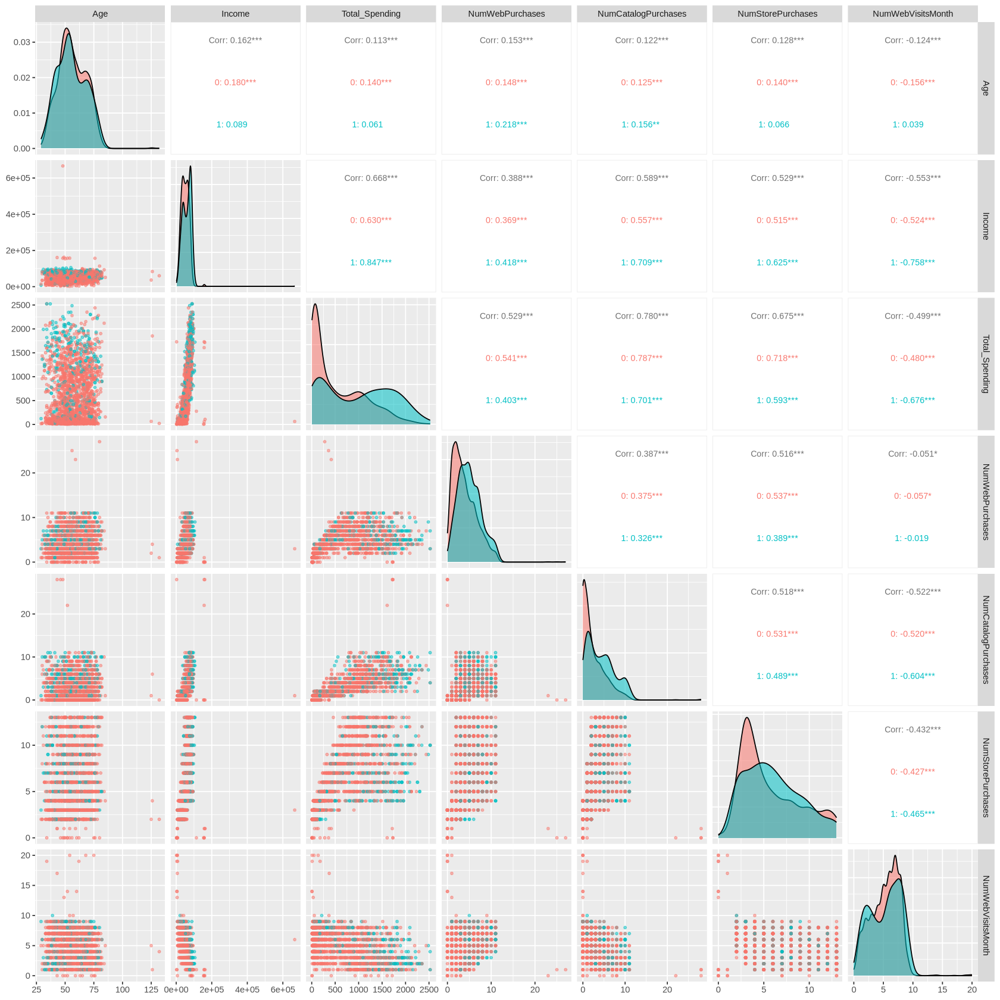

In [11]:
df_numeric <- df %>%
  select(Response, Age, Income, Total_Spending, 
         NumWebPurchases, NumCatalogPurchases, 
         NumStorePurchases, NumWebVisitsMonth)

df_numeric$Response <- as.factor(df_numeric$Response)

options(repr.plot.width = 14, repr.plot.height = 14)  # setting size 

ggpairs(
  data = df_numeric,
  columns = 2:8,  
  aes(color = Response, alpha = 0.6), # GPT helped me with making this prettier
  upper = list(continuous = wrap("cor", size = 3)),
  lower = list(continuous = wrap("points", size = 1, alpha = 0.5)),
  diag = list(continuous = wrap("densityDiag")))

It is observed that the difference in distribution between people who responded to the latest marketting campaign and people who did not. `Total_Spending` is highly correlated with all three types of purchases—web, catalog, and store—suggesting multicollinearity, so more attention should to paid later in the model. Additionally, customers who responded (in turquoise) tend to cluster in higher purchase and spending ranges, so there is some pattern in spending behaviour and response. 


#### Plots we should look at : 
1. Demographic vs Response
- Education
- Marital Status
- Complain
  
2. Numerical Predictors vs Response
- Age
- Income
- Total Spending
  
3. Behavioral Features vs Response
- Website Purchases
- Catalog Purchases
- Store Purchases
- Website visits

4. Correlation Between Variables

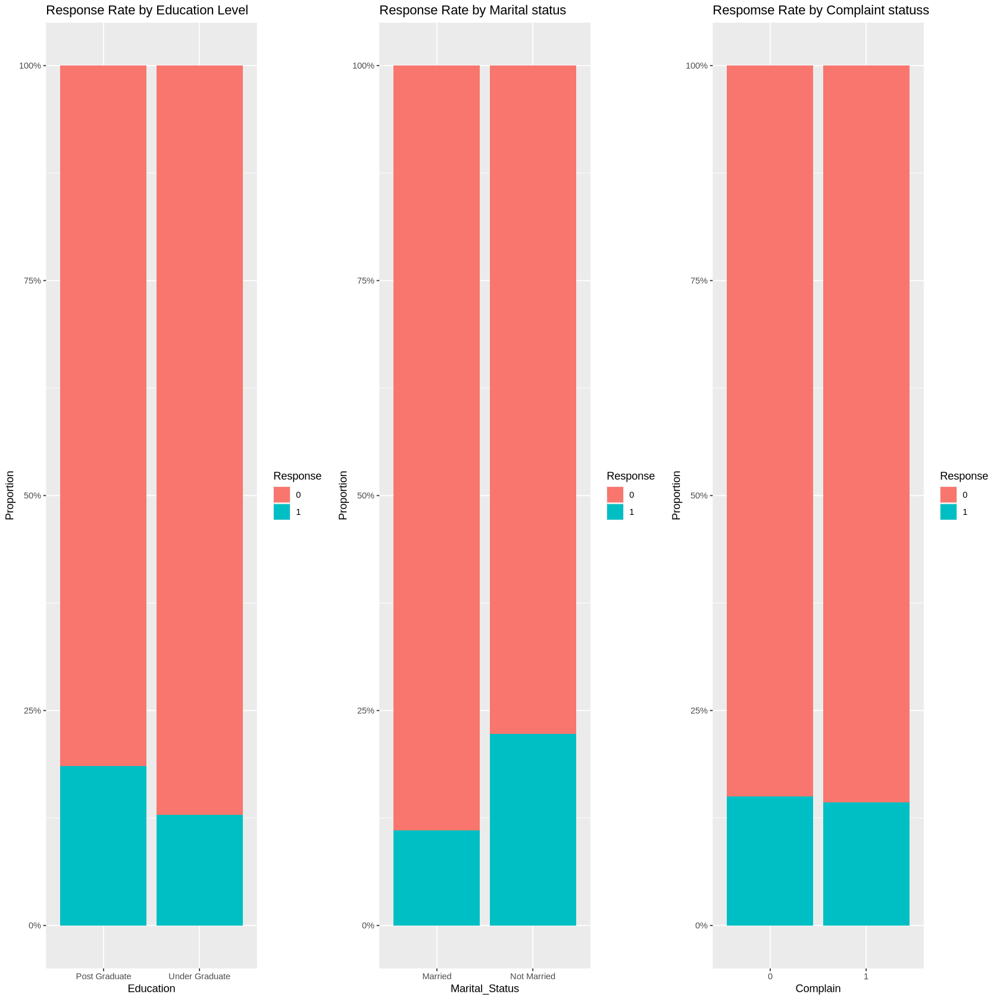

In [12]:
# 1a. Education vs Response 
edu_plot <- ggplot(df, aes(x = Education, fill = factor(Response))) +
    geom_bar(position = "fill")+
    scale_y_continuous(labels = scales::percent)+
    labs(title = "Response Rate by Education Level", y = "Proportion", fill = "Response")

# 1b. Marital Status vs Response
marital_plot <- ggplot(df, aes(x = Marital_Status, fill = factor(Response))) +
    geom_bar(position = "fill") +
    scale_y_continuous(labels = scales::percent) +
    labs(title = "Response Rate by Marital status", y = "Proportion",fill = "Response")

# 1c. Complain vs Response
complain_plot <- ggplot(df, aes(x = factor(Complain), fill = factor(Response))) +
    geom_bar(position = "fill") +
    scale_y_continuous(labels = scales::percent) +
    labs(title = "Respomse Rate by Complaint statuss",x = "Complain", y = "Proportion", fill = "Response")

# Combined plot !
plot_grid(
  edu_plot, marital_plot, complain_plot,
  ncol = 3)

Customers who are married/postgraduates are a bit more likely to respond to the campaign than their counterparts. Interestingly, those who **did not  complain** are marginally more responsive than those who did, so it is hypothesized that satisfaction might influence engagement.


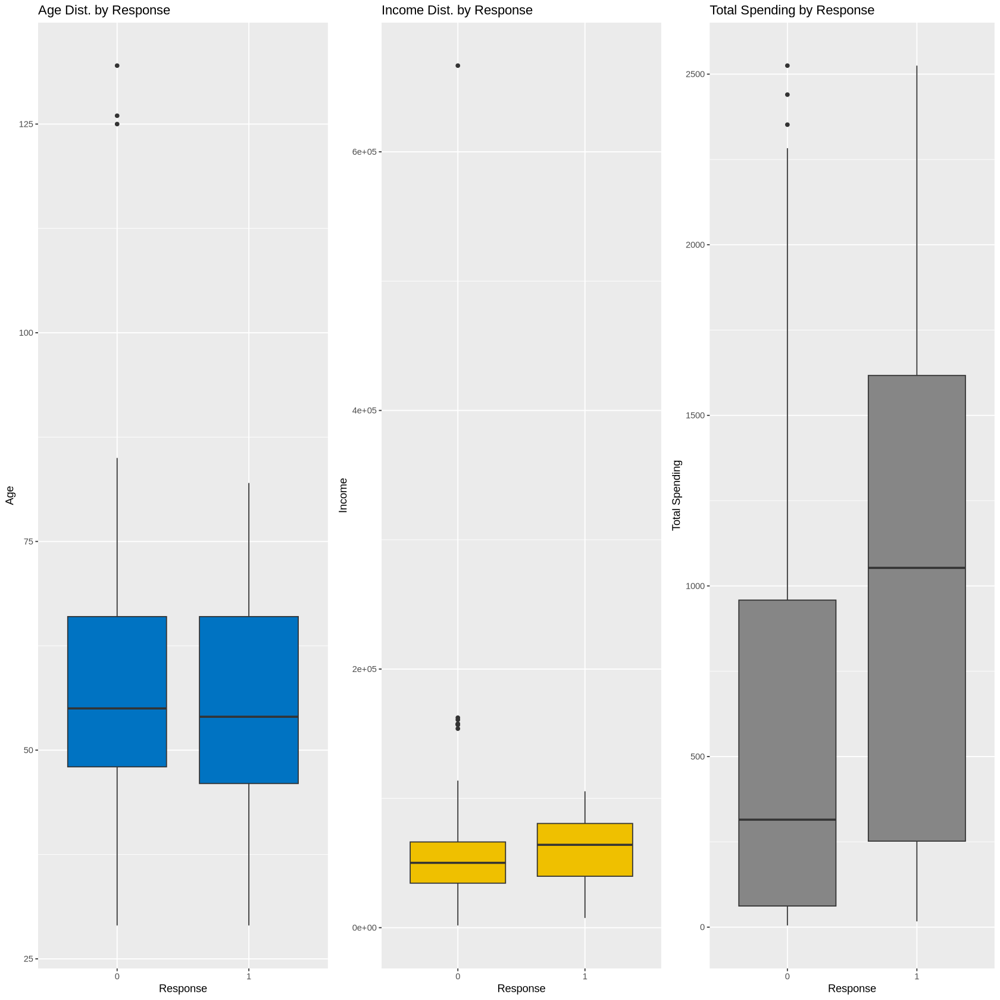

In [13]:
# I used ChatGPT for the different colors here !
# 2a. Age vs Response
ageplot <- ggplot(df, aes(x = factor(Response), y = Age)) +
  geom_boxplot(fill = "#0073C2FF") +
  labs(title = "Age Dist. by Response", x = "Response", y = "Age")

# 2b. Income vs Response
income_plot <- ggplot(df, aes(x = factor(Response), y = Income))+
  geom_boxplot(fill = "#EFC000FF") +
  labs(title = "Income Dist. by Response",x = "Response", y = "Income")

# 2c. Total Spending vs Response
totalspend_plot <- ggplot(df, aes(x = factor(Response), y = Total_Spending)) +
  geom_boxplot(fill = "#868686FF") +
  labs(title = "Total Spending by Response", x = "Response", y = "Total Spending")

# Combined plot !
plot_grid(
    ageplot,income_plot,totalspend_plot,
  ncol = 3)

Customers who responded to the marketing campaign tend to have higher total spending and slightly higher income than non-responders. Age distributions are the same across both groups, which means age is less important in predicting campaign response.


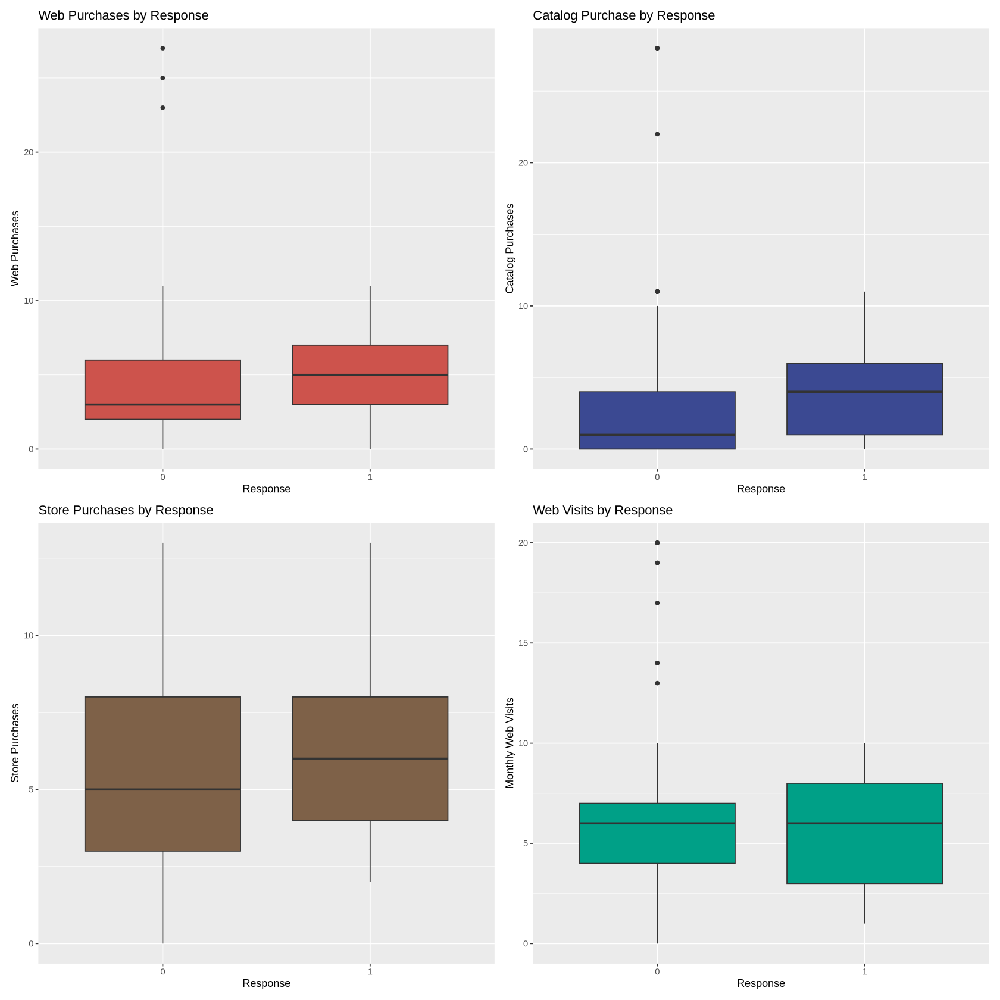

In [14]:
# I used ChatGPT for the different colors here !
# 3A. NumWebPurchases vs Response
NumWebPurchases_plot<-ggplot(df, aes(x = factor(Response), y = NumWebPurchases)) +
  geom_boxplot(fill = "#CD534CFF") +
  labs(title = "Web Purchases by Response", x = "Response", y = "Web Purchases")

# 3B. NumCatalogPurchases vs Response
NumCatalogPurchases_plot<-ggplot(df, aes(x = factor(Response), y = NumCatalogPurchases)) +
  geom_boxplot(fill = "#3B4992FF") +
  labs(title = "Catalog Purchase by Response", x = "Response", y = "Catalog Purchases")

# 3C. NumStorePurchases vs Response
NumStorePurchases_plot<-ggplot(df, aes(x = factor(Response), y = NumStorePurchases))+
  geom_boxplot(fill = "#7E6148FF") +
  labs(title = "Store Purchases by Response", x = "Response", y = "Store Purchases")

# 3D. NumWebVisitsMonth vs Response
NumWebVisitsMonth_plot<-ggplot(df, aes(x = factor(Response), y = NumWebVisitsMonth))+
  geom_boxplot(fill = "#00A087FF") +
  labs(title = "Web Visits by Response", x = "Response", y = "Monthly Web Visits")

NumWebPurchases_plot+NumCatalogPurchases_plot+NumStorePurchases_plot+NumWebVisitsMonth_plot

Customers who responded to the campaign tend to have slightly higher web and catalog purchases, suggesting a link between online/catalog buying behavior and campaign acceptance. In contrast, store purchases and web visits show little to no difference, indicating they are less important in predicting response.


#### 4. Correlation Heatmap (predictors for customer response) 

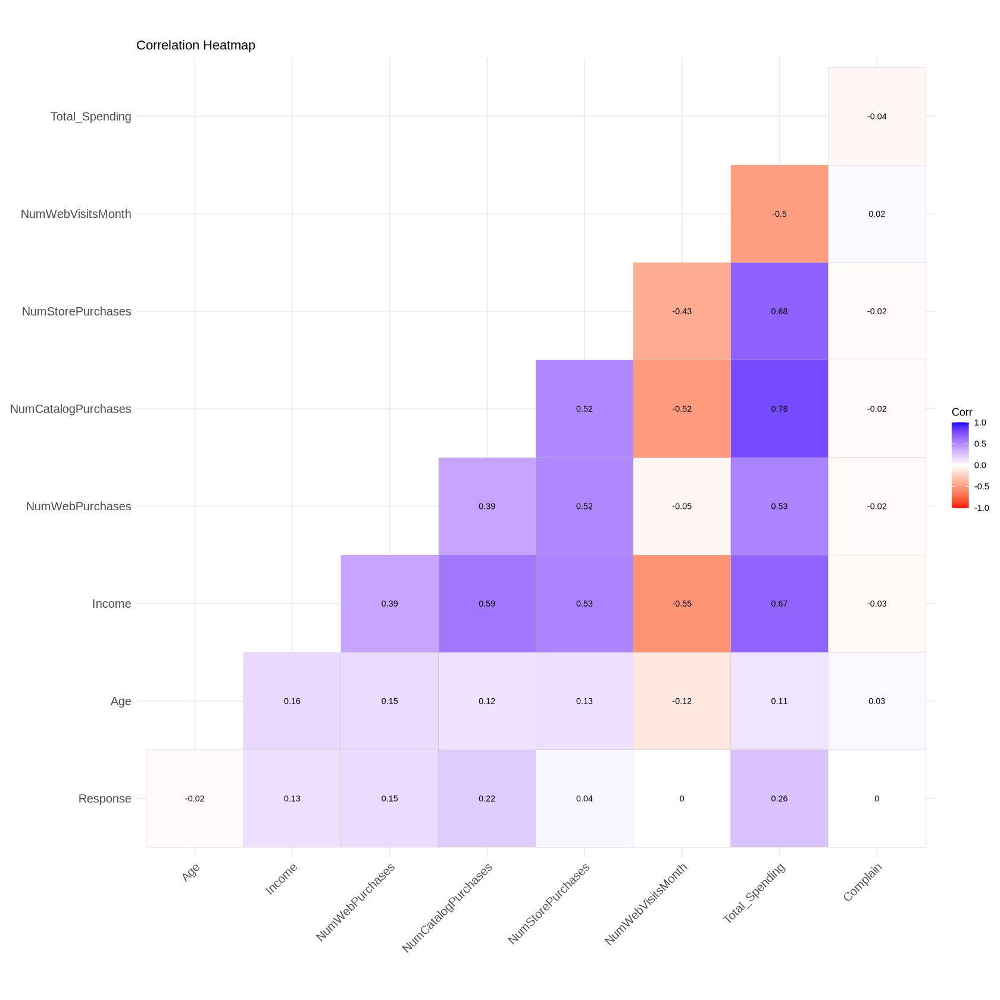

In [15]:
cor_vars <- df |>
  select(Response, Age, Income, NumWebPurchases, NumCatalogPurchases,
         NumStorePurchases, NumWebVisitsMonth, Total_Spending, Complain)

cor_matrix <- cor(cor_vars, use = "complete.obs")


ggcorrplot(cor_matrix,
           type = "lower",
           lab = TRUE,
           lab_size = 3,
           colors = c("red", "white", "blue"),
           title = "Correlation Heatmap",
           show.legend = TRUE)


From this it is observed that total_spending is the best predictor of response, number of catalog and web purchases also help, but there is overlap with total spending. 

# (4) Methods and Plan

A logistic regression model is used to predict whether a customer will respond to a marketing campaign (Response is binary), using `glm()` with the `family = binomial` argument.

$$
\log\left( \frac{P(\text{Response}_i = 1)}{1 - P(\text{Response}_i = 1)} \right) =
\beta_0 + \sum_{j=1}^{p} \beta_j X_{j,i} + \sum_{\substack{t=1 \\ j \ne k}}^{q} \gamma_t (X_{j,i} \cdot X_{k,i})
$$

**Where:**

- $ \text{Response}_i $ is the binary outcome (1 = responded, 0 = did not respond)  
- $ X_{j,i} $ are the predictor variables for observation $ i $  (listed above)
- $ \beta_0 $ is the intercept  
- $ \beta_j $ are coefficients for main effects  
- $ \gamma_t $ are coefficients for interaction effects


After fitting the full model, variables chosen are the ones that are most significant and simplify the model, while ensuring model is valid. These are the **diagnostic checks** I plan to perform:

- **Multicollinearity:** Carry out a Variance Inflation Factor (VIF). Variables with high VIFs (>5/>10) are considered for removal to reduce redundancy and improve model interpretability.
- **Linearity of Log-Odds:** Visually verify, to ensure the relationship between continuous predictors and the logit of the response is approximately linear.
- **Independence:** Assumed based on the design of the dataset (no repeated measures or clustering).
- **Goodness-of-Fit:** Checked using a residual Q-Q plot to assess the distribution of deviance residuals. Deviations from the diagonal line would indicate model misfit.

This will improve the models predictive power. 

### Justification for Method

Logistic regression is suitable for a binary response variable and allows for interpretability of coefficients.  
It accommodates both categorical and continuous predictors.  
Adding interaction terms enables detection of heterogeneity across groups (e.g, whether marital status changes the effect of income).

---

### Assumptions

- Observations are independent.
- Response variable is conditionally independant of all other variables given the predictor is included in the model.
- Log-odds of the outcome are linearly related to predictors.  
- Predictors are not strongly collinear (variables highly correlated with each other).  
- Sufficient sample size to ensure stable estimates.  

---

### Limitations

- Causality, this model may not be causal. What if education or marketting affects income and response ? or What if customer loyalty affects reponse ? But we dont record it in the dataset. So we should not make causal claims like "Higher Income causes a higher probability of response"
- Assumes linearity in the logit, which may not hold for all variables.  
- Sensitive to outliers and influential points.
- If the relationships we see are highly non-linnear we may need another model (random forrest which we havent covered in class might be better suited)
- Class imbalance (if present) could affect predictive performance.
___

# (5) Results

First, we need to build a full logistic regression model to first select variables with the highest statistical significance, so that we can further evaluate their effects and relevance.

In [16]:
# Full logistic regression model
model_full <- glm(Response ~ Age + Income + Education + Marital_Status +
                    Complain + NumWebPurchases + NumCatalogPurchases +
                    NumStorePurchases + NumWebVisitsMonth + Total_Spending,
                  data = df,
                  family = binomial)
summary(model_full)


Call:
glm(formula = Response ~ Age + Income + Education + Marital_Status + 
    Complain + NumWebPurchases + NumCatalogPurchases + NumStorePurchases + 
    NumWebVisitsMonth + Total_Spending, family = binomial, data = df)

Coefficients:
                            Estimate Std. Error z value Pr(>|z|)    
(Intercept)               -2.734e+00  4.587e-01  -5.959 2.53e-09 ***
Age                       -1.482e-02  5.597e-03  -2.648  0.00810 ** 
Income                     1.456e-06  3.884e-06   0.375  0.70771    
EducationUnder Graduate   -4.809e-01  1.336e-01  -3.599  0.00032 ***
Marital_StatusNot Married  9.274e-01  1.314e-01   7.058 1.69e-12 ***
Complain                   3.562e-01  6.808e-01   0.523  0.60079    
NumWebPurchases            5.686e-02  2.632e-02   2.160  0.03074 *  
NumCatalogPurchases        8.524e-02  3.100e-02   2.750  0.00597 ** 
NumStorePurchases         -1.803e-01  2.784e-02  -6.477 9.34e-11 ***
NumWebVisitsMonth          1.845e-01  3.340e-02   5.525 3.29e-08 ***
Tot

> We first select variables with the highest statistical significance (p < 0.001, marked as `***`). These are **Intercept, Education (Under Graduate), Marital\_Status (Not Married), NumStorePurchases, NumWebVisitsMonth, and Total\_Spending**. These variables will be taken forward for the next step of screening, where we will further evaluate their effect sizes and relevance to the model.

Also, we can find from the table that 
> **Marital\_Status, NumWebVisitsMonth, and Total\_Spending** have positive association with the response. \
> **Education, NumStorePurchases** have negative association with the response

In [17]:
vif_values <- vif(model_full)
vif_values

ERROR: Error in vif(model_full): could not find function "vif"



### References
imakash3011. (n.d.). Customer Personality Analysis [Data set]. Kaggle. Retrieved July 27, 2025, from https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis/data